<center><a href="https://www.pieriandata.com">pieriandata</a></center>
<strong><center>task Copyright by Pierian Data Inc.</center></strong> 
<strong><center>task Created by Jose Marcial Portilla.</center></strong>

We will be using data from a Kaggle data set:

https://www.kaggle.com/harlfoxem/housesalesprediction

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

# The Data

In [4]:
df = pd.read_csv('../DATA/kc_house_data.csv')

In [5]:
df.isnull().sum() # counting missing data

id               0
date             0
price            0
bedrooms         0
bathrooms        0
sqft_living      0
sqft_lot         0
floors           0
waterfront       0
view             0
condition        0
grade            0
sqft_above       0
sqft_basement    0
yr_built         0
yr_renovated     0
zipcode          0
lat              0
long             0
sqft_living15    0
sqft_lot15       0
dtype: int64

In [6]:
df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
id,21597.0,4.580474e+09,2.876736e+09,1.000102e+06,2.123049e+09,3.904930e+09,7.308900e+09,9.900000e+09
price,21597.0,5.402966e+05,3.673681e+05,7.800000e+04,3.220000e+05,4.500000e+05,6.450000e+05,7.700000e+06
bedrooms,21597.0,3.373200e+00,9.262989e-01,1.000000e+00,3.000000e+00,3.000000e+00,4.000000e+00,3.300000e+01
bathrooms,21597.0,2.115826e+00,7.689843e-01,5.000000e-01,1.750000e+00,2.250000e+00,2.500000e+00,8.000000e+00
sqft_living,21597.0,2.080322e+03,9.181061e+02,3.700000e+02,1.430000e+03,1.910000e+03,2.550000e+03,1.354000e+04
sqft_lot,21597.0,1.509941e+04,4.141264e+04,5.200000e+02,5.040000e+03,7.618000e+03,1.068500e+04,1.651359e+06
floors,21597.0,1.494096e+00,5.396828e-01,1.000000e+00,1.000000e+00,1.500000e+00,2.000000e+00,3.500000e+00
waterfront,21597.0,7.547345e-03,8.654900e-02,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00
view,21597.0,2.342918e-01,7.663898e-01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,4.000000e+00
condition,21597.0,3.409825e+00,6.505456e-01,1.000000e+00,3.000000e+00,3.000000e+00,4.000000e+00,5.000000e+00


<AxesSubplot:xlabel='price', ylabel='Count'>

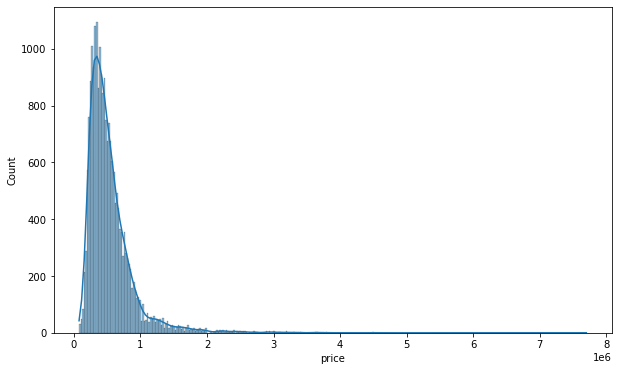

In [7]:
plt.figure(figsize=(10,6))
sns.histplot(data = df['price'], kde=True)

<AxesSubplot:xlabel='bedrooms', ylabel='count'>

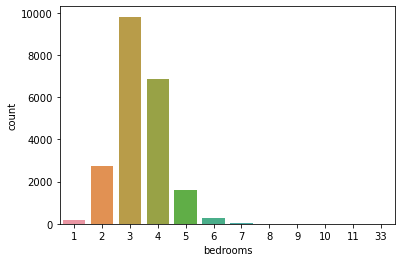

In [8]:
sns.countplot(x=df['bedrooms'])

In [9]:
df.corr()['price'].sort_values()

zipcode         -0.053402
id              -0.016772
long             0.022036
condition        0.036056
yr_built         0.053953
sqft_lot15       0.082845
sqft_lot         0.089876
yr_renovated     0.126424
floors           0.256804
waterfront       0.266398
lat              0.306692
bedrooms         0.308787
sqft_basement    0.323799
view             0.397370
bathrooms        0.525906
sqft_living15    0.585241
sqft_above       0.605368
grade            0.667951
sqft_living      0.701917
price            1.000000
Name: price, dtype: float64

a good practice is to explore highly correlated features in a scatterplot

<AxesSubplot:xlabel='price', ylabel='sqft_living'>

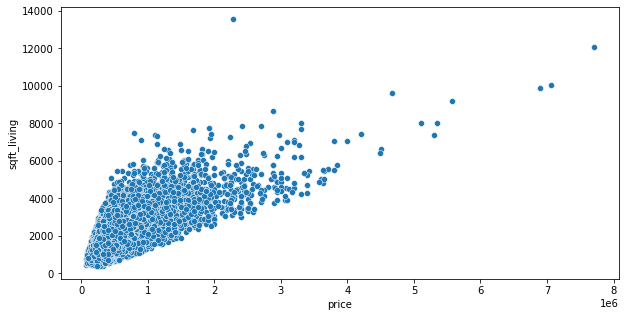

In [10]:
plt.figure(figsize=(10,5))
sns.scatterplot(data = df, x='price', y='sqft_living')

<AxesSubplot:xlabel='bedrooms', ylabel='price'>

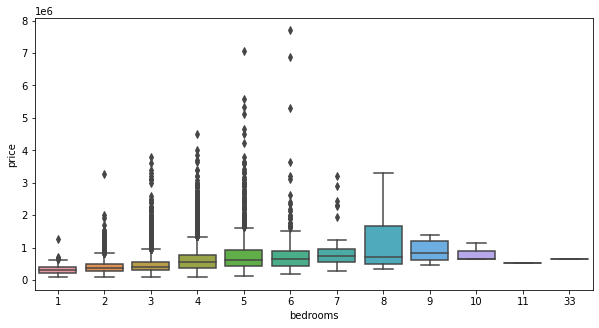

In [11]:
plt.figure(figsize=(10,5))
sns.boxplot(x='bedrooms', y='price', data=df)

In [12]:
df.columns

Index(['id', 'date', 'price', 'bedrooms', 'bathrooms', 'sqft_living',
       'sqft_lot', 'floors', 'waterfront', 'view', 'condition', 'grade',
       'sqft_above', 'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode',
       'lat', 'long', 'sqft_living15', 'sqft_lot15'],
      dtype='object')

<AxesSubplot:xlabel='waterfront', ylabel='price'>

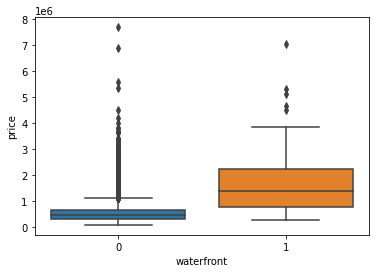

In [13]:
sns.boxplot(data = df, x = 'waterfront', y = 'price')

<AxesSubplot:xlabel='price', ylabel='long'>

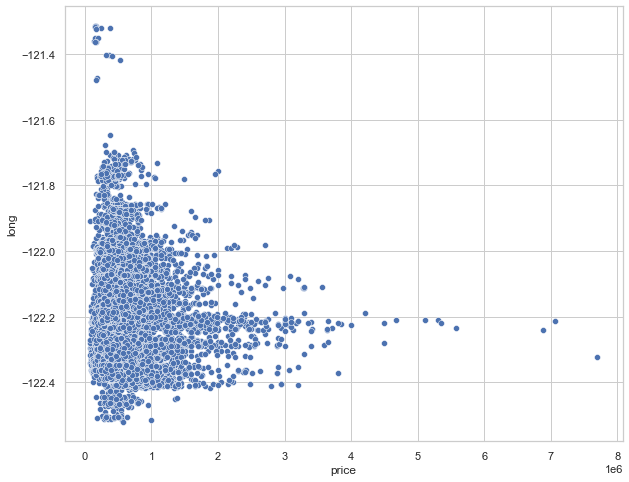

In [14]:
sns.set(rc={'axes.facecolor':'white'})
sns.set_style('whitegrid')
plt.figure(figsize = (10,8))
sns.scatterplot(x='price', y='long', data = df) #lat and long interest me

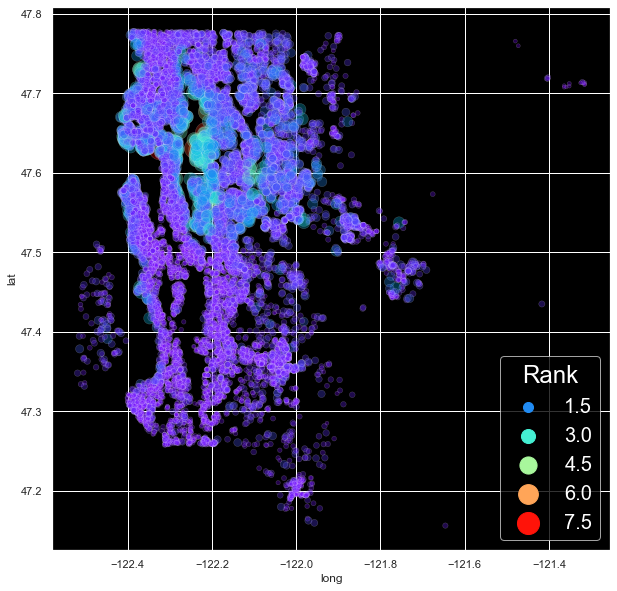

In [15]:
sns.set(rc={'axes.facecolor':'black', "text.color":'white'})
plt.figure(figsize=(10,10))
ax = sns.scatterplot(data = df, x = 'long', y = 'lat', hue = 'price', size = 'price', sizes=(10, 500), palette='rainbow', alpha=0.3)
ax.legend(title='Rank', title_fontsize=24, fontsize=20, labelcolor='white')

as we saw ealier in the histogram, mose of the houses are in the price range 2-3 million... there's a problem trying to show all the data in one graph. so we're going to look at some different sections of te data sperately

In [16]:
df.sort_values('price', ascending=False).head(20) #top 20 

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
7245,6762700020,10/13/2014,7700000.0,6,8.00,12050,27600,2.5,0,3,...,13,8570,3480,1910,1987,98102,47.6298,-122.323,3940,8800
3910,9808700762,6/11/2014,7060000.0,5,4.50,10040,37325,2.0,1,2,...,11,7680,2360,1940,2001,98004,47.6500,-122.214,3930,25449
9245,9208900037,9/19/2014,6890000.0,6,7.75,9890,31374,2.0,0,4,...,13,8860,1030,2001,0,98039,47.6305,-122.240,4540,42730
4407,2470100110,8/4/2014,5570000.0,5,5.75,9200,35069,2.0,0,0,...,13,6200,3000,2001,0,98039,47.6289,-122.233,3560,24345
1446,8907500070,4/13/2015,5350000.0,5,5.00,8000,23985,2.0,0,4,...,12,6720,1280,2009,0,98004,47.6232,-122.220,4600,21750
1313,7558700030,4/13/2015,5300000.0,6,6.00,7390,24829,2.0,1,4,...,12,5000,2390,1991,0,98040,47.5631,-122.210,4320,24619
1162,1247600105,10/20/2014,5110000.0,5,5.25,8010,45517,2.0,1,4,...,12,5990,2020,1999,0,98033,47.6767,-122.211,3430,26788
8085,1924059029,6/17/2014,4670000.0,5,6.75,9640,13068,1.0,1,4,...,12,4820,4820,1983,2009,98040,47.5570,-122.210,3270,10454
2624,7738500731,8/15/2014,4500000.0,5,5.50,6640,40014,2.0,1,4,...,12,6350,290,2004,0,98155,47.7493,-122.280,3030,23408
8629,3835500195,6/18/2014,4490000.0,4,3.00,6430,27517,2.0,0,0,...,12,6430,0,2001,0,98004,47.6208,-122.219,3720,14592


In [17]:
len(df)

21597

ten percent of the houses dataset is 215 houses, we're going to address these two groups seperatly.

In [18]:
non_top_1_percent = df.sort_values('price', ascending=False).iloc[216:]

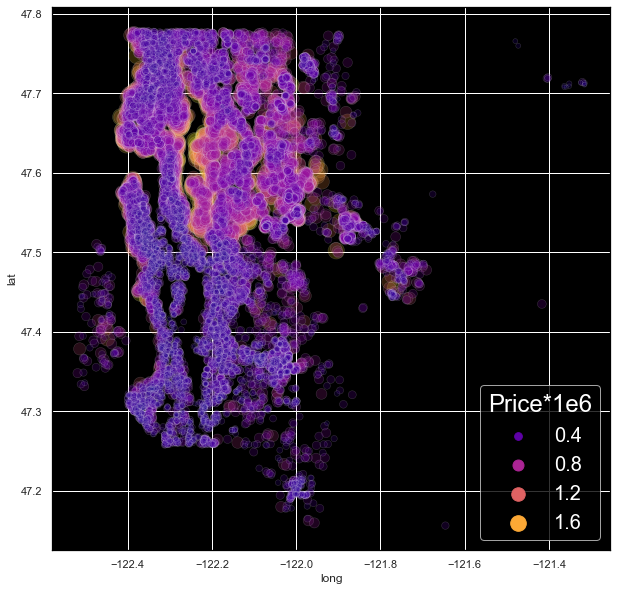

In [19]:
sns.set(rc={'axes.facecolor':'black','text.color': '1', 'axes.edgecolor': '0'})
plt.figure(figsize=(10,10))
ax = sns.scatterplot(data = non_top_1_percent, x = 'long', y = 'lat', hue = 'price', size = 'price', sizes = (10,300), palette='plasma', alpha=0.2) #.legend(title='Price*1e6', edgecolor='black', loc=4)
ax.legend(title='Price*1e6', title_fontsize=24, fontsize=20, labelcolor='white')

In [20]:
box_boundries = (
    df.long.min(),
    df.long.max(),
    df.lat.min(), 
    df.lat.max()
)

box_boundries

(-122.519, -121.315, 47.1559, 47.7776)

In [21]:
kc_img = plt.imread('kingcounty_seattle2.png')

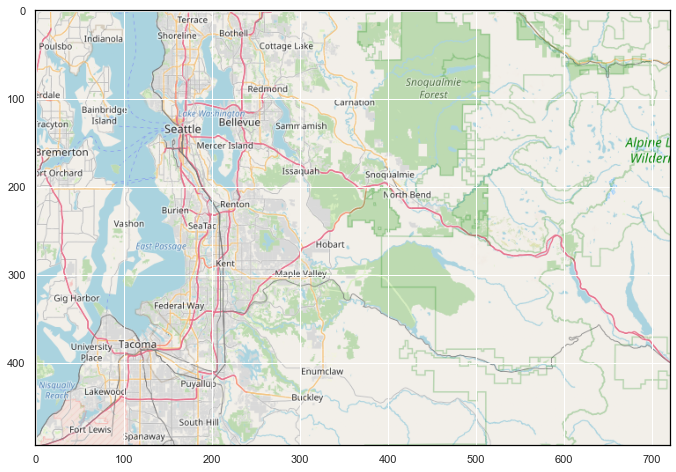

In [22]:
plt.figure(figsize=(12,8))
plt.imshow(kc_img)

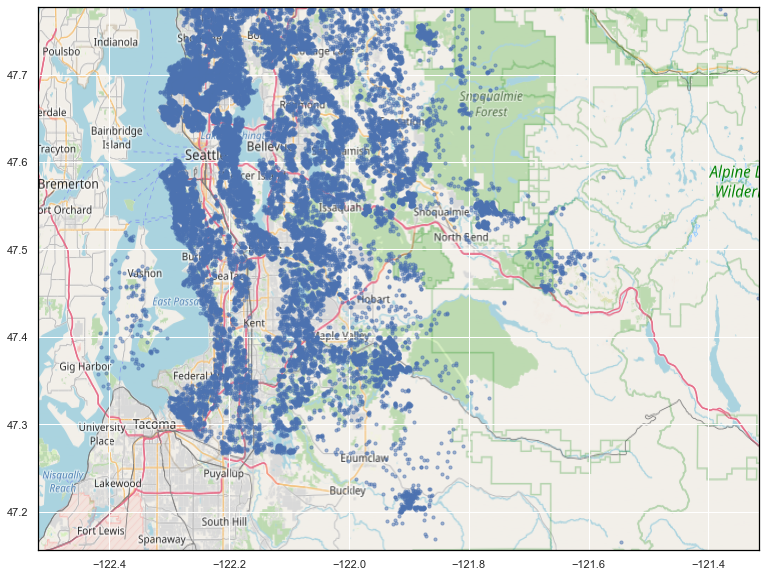

In [23]:
fig, ax = plt.subplots(figsize=(14.6,10))
ax.scatter(x=(df.long+0.1), y=(df.lat+0.01), alpha =0.5, s=10)
# ax.set_title('Plotting Spatial Data on King County Map')
ax.set_xlim(box_boundries[0],box_boundries[1])
# ax.set_ylim(box_boundries[2],box_boundries[3])
ax.imshow(kc_img, zorder=0, extent = box_boundries, aspect=1.46)

essantially it doesn't matter how much I played with the lat and long... and the aspect ratio - the dots don't fall in place :-(

The map I created without the osm map (with the dark layout in the back) is much better. I'll try now to use folium// just before quitting. hope folium will not disappoint!

In [24]:
import folium

In [25]:
locations = non_top_1_percent[['lat','long','price']]

In [26]:
map_osm = folium.Map(location=[47.5, -122.055], zoom_start=10)
map_osm

In [27]:
map_dark = folium.Map(location=[47.5, -122.055], tiles='CartoDB dark_matter', zoom_start=10)
map_dark

In [28]:
locations_list = locations.values.tolist()

In [29]:
locations_list[:4]

[[47.5876, -122.204, 1970000.0],
 [47.5632, -122.215, 1960000.0],
 [47.5287, -122.22, 1960000.0],
 [47.6422, -122.157, 1960000.0]]

In [30]:
# for point in locations_list:
#     folium.Circle(location=[point[0], point[1]], radius=point[2]/10000, opacity = 0.5).add_to(map_osm)
#     folium.Circle(location=[point[0], point[1]], radius=point[2]/10000, opacity = 0.5).add_to(map_dark)
    
# map_dark

the sectionabove really jammed the computer. the radius attribute of the circle object did not render well. going to repeat with a fixed radius

In [31]:
for point in locations_list:
    folium.Circle(location=[point[0], point[1]], radius=20, fill=True, opacity = 0.5).add_to(map_osm)
    folium.Circle(location=[point[0], point[1]], radius=20, fill=True, opacity = 0.5).add_to(map_dark)
map_dark

In [32]:
map_osm

-- Folium WINS. hands down. 

# Feature engineering

In [33]:
df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,10/13/2014,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,12/9/2014,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,2/25/2015,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,12/9/2014,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,2/18/2015,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


### plans:
1. taking off the id column
2. convert the date column to datetime

In [34]:
df = df.drop('id', axis=1)

In [35]:
df['date'].dtype

dtype('O')

In [36]:
df['date'] = pd.to_datetime(df['date'])

In [38]:
#df['date']

In [39]:
df['year'] = df['date'].apply(lambda date: date.year)

In [40]:
df['month'] = df['date'].apply(lambda date: date.month)

In [41]:
# now the df['date'] is redundant

In [42]:
df = df.drop('date', axis=1)

In [44]:
df.head()

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,...,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,year,month
0,221900.0,3,1.00,1180,5650,1.0,0,0,3,7,...,0,1955,0,98178,47.5112,-122.257,1340,5650,2014,10
1,538000.0,3,2.25,2570,7242,2.0,0,0,3,7,...,400,1951,1991,98125,47.7210,-122.319,1690,7639,2014,12
2,180000.0,2,1.00,770,10000,1.0,0,0,3,6,...,0,1933,0,98028,47.7379,-122.233,2720,8062,2015,2
3,604000.0,4,3.00,1960,5000,1.0,0,0,5,7,...,910,1965,0,98136,47.5208,-122.393,1360,5000,2014,12
4,510000.0,3,2.00,1680,8080,1.0,0,0,3,8,...,0,1987,0,98074,47.6168,-122.045,1800,7503,2015,2


I'll check to find any substantial correlation between price and month/year attributes:

<AxesSubplot:xlabel='year'>

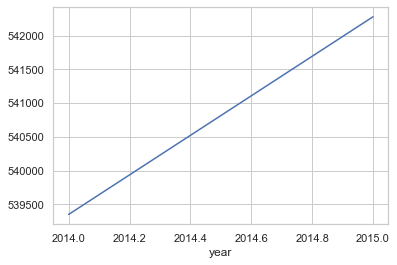

In [52]:
df.groupby('year').mean()['price'].plot()

we found a substantial correlation with the year attribute, which also makes sense

<AxesSubplot:xlabel='month'>

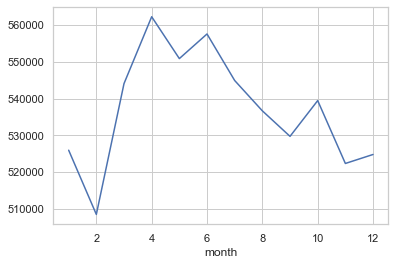

In [54]:
df.groupby('month').mean()['price'].plot()

all prices fluctuate around the 530000 dollars.. there is much less significance to month attribute (than the year the house was sold in), but we'll keep that feature for the sake of the 5% price change... 

the zipcode is a categorical variable! it's not continous, lets see how many values it holds

In [55]:
df['zipcode'].value_counts()

98103    602
98038    589
98115    583
98052    574
98117    553
        ... 
98102    104
98010    100
98024     80
98148     57
98039     50
Name: zipcode, Length: 70, dtype: int64

70! unlogical to format it as dummies variables. maybe grouping the data around expensive zipcodes or rigional... but I don't have the domain experience of king county to go deeper in that direction. for this use case I'll drop this column.

In [56]:
df = df.drop('zipcode', axis=1)

lets check some more attribues:

In [57]:
df['yr_renovated'].value_counts()

0       20683
2014       91
2013       37
2003       36
2007       35
        ...  
1948        1
1954        1
1951        1
1944        1
1959        1
Name: yr_renovated, Length: 70, dtype: int64

0 is not actually a year. It's an indication that the house was never renovated. what we could do is  engineer that column with an .apply method to have 1 for renovated and 0 for never renovated. but we can actually keep the data the way it is. We can embrase the correlation that already exists. Essentialy, never renovated house (or an old renovation date) corresponds to lower selling prices, and the higher the year of renovation is, the higher the price of the house.

In [58]:
df['sqft_basement'].value_counts()

0       13110
600       221
700       218
500       214
800       206
        ...  
65          1
1248        1
172         1
1920        1
1135        1
Name: sqft_basement, Length: 306, dtype: int64

similar situation as with the yr_renovated. we'll keep those as they are.

# Modeling

In [59]:
X = df.drop('price', axis=1).values
y = df['price'].values

In [60]:
from sklearn.model_selection import train_test_split

In [61]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=101)

### scaling

In [62]:
from sklearn.preprocessing import MinMaxScaler

In [63]:
scaler=MinMaxScaler()

In [64]:
X_train = scaler.fit_transform(X_train)

In [98]:
X_test = scaler.transform(X_test) 

we don't want to fit_transform the test data to prevent data liquege

importing TF and Keras essentials

In [67]:
X_train.shape

(15117, 19)

The model has to deal with 19 incoming features. it means that it's good to have 19 incoming layers...

In [66]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense

In [69]:
model = Sequential()

model.add(Dense(19, activation='relu'))
model.add(Dense(19, activation='relu'))
model.add(Dense(19, activation='relu'))
model.add(Dense(19, activation='relu')) # could be an over kill, I'll check that later

model.add(Dense(1))

model.compile(optimizer = 'adam', loss = 'mse')

the validation data will not affect the weights and biases of the network, but it will countinuosly check to see how well it's doing
because it's a large dataset, we're going to feed it to the model in batches

it's common to  feed batches sizes in powers of 2. the smaller the batchs - the longer the training is going to take, but less likelihood of overfitting

later we'll use a better machenism for chooing number of epochs

In [74]:
# model.fit(
#     x = X_train, 
#     y = y_train, 
#     validation_data = (X_test, y_test), 
#     batch_size = 128, 
#     epochs = 400
# ) 

In [73]:
pd.DataFrame(model.history.history)

,loss,val_loss
0,4.302283e+11,4.188497e+11
1,4.285006e+11,4.130803e+11
2,4.064824e+11,3.635670e+11
3,3.052797e+11,2.104812e+11
4,1.471491e+11,1.004516e+11
...,...,...
395,2.997356e+10,2.753247e+10
396,2.997046e+10,2.755927e+10
397,2.991545e+10,2.754251e+10
398,2.989920e+10,2.766187e+10


In [75]:
# we can directly compare how our model did on the training set (loss) and on our test set (val_loss)
losses = pd.DataFrame(model.history.history)

<AxesSubplot:>

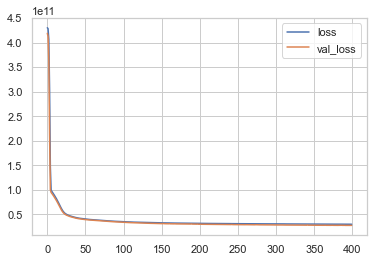

In [76]:
losses.plot()

we can see that around 100-150 epochs, our model is not getting much better

if the orange line went over the blue line up and up that means we happend to overfit the model to the training data

## Evaluating the model

In [84]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, explained_variance_score

In [78]:
predictions = model.predict(X_test)

In [82]:
mean_absolute_error(y_test, predictions) #MAE

102394.25877700618

In [81]:
np.sqrt(mean_squared_error(y_test, predictions)) #RMSE

165817.95500618967

is it good or bad? depands on the values and our goal

our mean price is:

In [83]:
df['price'].describe()

count    2.159700e+04
mean     5.402966e+05
std      3.673681e+05
min      7.800000e+04
25%      3.220000e+05
50%      4.500000e+05
75%      6.450000e+05
max      7.700000e+06
Name: price, dtype: float64

5.402966e+05

which means the error is pretty terrible - about 20% (102394/540300).
we can evaluate with the variance score as well:

In [85]:
explained_variance_score(y_test, predictions) #how much is explained by the model. at best = 1

0.7926797658915624

that's ok. not great. maybe it's good to keep the practicing the model since I haven't reached overfitting. hance even increasing the number of epochs rather than decreasing it. first let's see if we can find a trend with plotting the data.

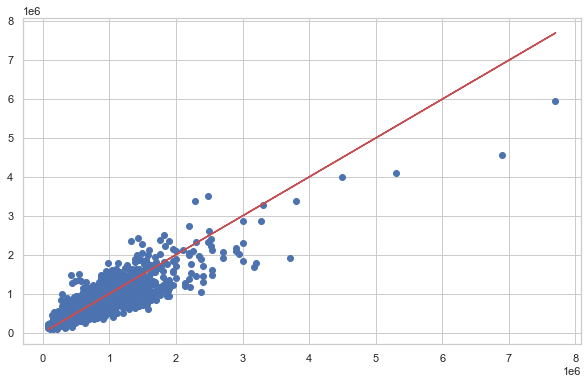

In [87]:
plt.figure(figsize = (10,6))
plt.scatter(y_test, predictions)
plt.plot(y_test, y_test, 'r') # the best prediction line is represented in red line

I can see that our predictions don't make a straight line with the real test values. the best prediction line is represented in red line.
there's a relatively goo fit for houses between the values of 0-2M USD. and that explained variance score is trying to portray in one number. the bottom of 99 percent is explained by the model pretty well, and any given house in that range could be explained as well. is someone were to ask about a house in the price range 6-7 M USD, we should discard by knowing our model will not predict well.

### predicting the price on a brand new house 

In [90]:
df.head()

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,lat,long,sqft_living15,sqft_lot15,year,month
0,221900.0,3,1.00,1180,5650,1.0,0,0,3,7,1180,0,1955,0,47.5112,-122.257,1340,5650,2014,10
1,538000.0,3,2.25,2570,7242,2.0,0,0,3,7,2170,400,1951,1991,47.7210,-122.319,1690,7639,2014,12
2,180000.0,2,1.00,770,10000,1.0,0,0,3,6,770,0,1933,0,47.7379,-122.233,2720,8062,2015,2
3,604000.0,4,3.00,1960,5000,1.0,0,0,5,7,1050,910,1965,0,47.5208,-122.393,1360,5000,2014,12
4,510000.0,3,2.00,1680,8080,1.0,0,0,3,8,1680,0,1987,0,47.6168,-122.045,1800,7503,2015,2


In [91]:
single_house = df.drop('price', axis=1).iloc[0] #a single house, given we know all the features, just an example

recall all the features are scaled.

In [92]:
single_house.values

array([ 3.00000e+00,  1.00000e+00,  1.18000e+03,  5.65000e+03,
        1.00000e+00,  0.00000e+00,  0.00000e+00,  3.00000e+00,
        7.00000e+00,  1.18000e+03,  0.00000e+00,  1.95500e+03,
        0.00000e+00,  4.75112e+01, -1.22257e+02,  1.34000e+03,
        5.65000e+03,  2.01400e+03,  1.00000e+01])

it's a numpy array. we need a different shape. so let's reshape:

In [93]:
single_house.values.reshape(-1,19) # adds another set of brackets. "-1" indicates to keep the old dimentions along that axis

array([[ 3.00000e+00,  1.00000e+00,  1.18000e+03,  5.65000e+03,
         1.00000e+00,  0.00000e+00,  0.00000e+00,  3.00000e+00,
         7.00000e+00,  1.18000e+03,  0.00000e+00,  1.95500e+03,
         0.00000e+00,  4.75112e+01, -1.22257e+02,  1.34000e+03,
         5.65000e+03,  2.01400e+03,  1.00000e+01]])

now I'll do the same only transform it with the scaler

In [95]:
single_house = scaler.transform(single_house.values.reshape(-1,19))

In [96]:
model.predict(single_house)

array([[279709.06]], dtype=float32)

In [97]:
df.head(1)

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,lat,long,sqft_living15,sqft_lot15,year,month
0,221900.0,3,1.0,1180,5650,1.0,0,0,3,7,1180,0,1955,0,47.5112,-122.257,1340,5650,2014,10


the price overshooted

a good practice would be to retrain the model after dropping the top 1 or 2 percent of the most expensive houses. then, try to predict again, in the relevent price zone. for now we'll end this project.

# END